In [1]:
import logging
import os
from math import isnan

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import json

from datetime import date
from pathlib import Path
from copy import deepcopy

from experiments.tad_help import AgentRunner

%load_ext autoreload
%autoreload 2

# Disable logging of the program in the notebook
os.environ["LOGLEVEL"] = "CRITICAL"

logging.basicConfig()
logging.root.setLevel(logging.INFO)
logging.basicConfig(level=logging.INFO)

logger = logging.getLogger('__main__')
logger.setLevel(os.environ.get("LOGLEVEL", logging.FATAL))

pybooklogger = logging.getLogger('pybook')
pybooklogger.setLevel(logging.DEBUG)

%aimport setup

from setup import *

# Track Layout
Calculate the layout of the dutch railway system


In [2]:
layout_file =   "../data/prorail/parsed/netherlands-schiphol.json"
layout = Layout(layout_file)

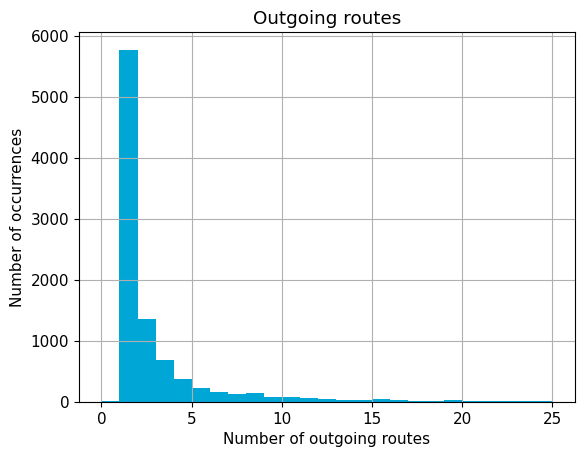

In [22]:
edges_df = pd.DataFrame({"Outgoing routes": [len(n.outgoing) for n in layout.g_block.nodes.values() if len(n.outgoing) <= 25]})
plt.rcParams.update({'font.size': 11})
hist = edges_df.hist(bins=25, color="#00A6D6")
plt.xlabel("Number of outgoing routes")
plt.ylabel("Number of occurrences")
plt.show()

In [3]:
scenario_file = Path("../data/prorail/scenarios/RT/2025-07-22_1.json")
interval = 1
repeats = 10
save_dir = Path(r"C:\Users\erick\Documents\uni\Thesis\delay-replannning\experiments\results\runtime_agents") / f"r{repeats}-i{interval}-{date.today()}"

# Experiment Runtime Agents


In [4]:
i_save_dir = save_dir / "intermediates"
i_save_dir.mkdir(parents=True, exist_ok=True)

rt_exp = AgentRunner(layout, scenario_file, save_dir)

..\data\prorail\scenarios\RT\2025-07-22_1.json


In [9]:
np.random.seed(42)
rt_exp.run("3500", "o", "RTB", "GV", repeats=10, interval=1, i_save_dir=i_save_dir)

INFO:pybook.setup:Setting up experiment {'start_time': np.float64(1380.0), 'origin': 'RTB|2', 'destination': 'GV|6', 'max_buffer_time': 900, 'use_recovery_time': True, 'filter_agents': {np.int64(26)}, 'metadata': {'expected_arrival': np.float64(3060.0), 'label': '0', 'repeat': '6', 'trains excluded': {np.int64(26)}, 'color': 'Red', 'offset': 0}, 'velocity': 38.888888888888886}


Completed repeats: [0, 1, 2, 3, 4, 5]


DEBUG:pybook.setup:Running: ../search/buildDir/atsipp.exe --start r-Rtd_Rtst|654 --goal r-Gv|244 --edgegraph output --search repeat --startTime 1380.0
DEBUG:pybook.setup:repeat output: ['<0,inf,inf,inf> <-inf,1422.45,2478.5,2478.5>', '<1422.45,inf,inf,inf> <-inf,1445.38,2478.5,2478.5>', '<1445.38,inf,inf,inf> <-inf,1580.31,2478.5,2478.5>', '<-inf,1445.38,2478.5,2478.5> <-inf,1580.31,2478.5,2478.5>', '<1580.31,inf,inf,inf> <-inf,1977.34,2638.74,2638.74>', '<1445.38,1580.31,2478.5,2478.5> <-inf,1977.34,2638.74,2638.74>', '<-inf,1445.38,2478.5,2478.5> <-inf,1445.38,2638.74,2638.74>', 'Nodes generated: 617 Nodes decreased: 87 Nodes expanded: 360', '<-inf,1422.45,2478.5,2478.5>, <-inf,1445.38,2478.5,2478.5>, <1445.38,1580.31,2478.5,2478.5>, <1580.31,1977.34,2638.74,2638.74>, <1977.34,inf,inf,inf>, ', 'r-Rtd_Rtst|654 <1144.73,1584.06> ns:1 []', 'r-Rtd|384 <1150.05,1606.38> ns:7 []', 'r-Rtd|278 <1375.87,1746.24> ns:13 []', 'r-Rtd|178 <1372.16,1720.68> ns:1 []', 'r-Rmoa_Rtd|168 <1396.07,1715.6

## Results


### Time statistics

In [14]:
save_path = Path(r"C:\Users\erick\Documents\uni\Thesis\delay-replannning\experiments\results\runtime_agents\r10-i1-2025-08-10\intermediates")

setup_cols = ["track graph creation", "routing graph creation"]
recompute_cols = ["unsafe interval generation", "safe interval generation", "bt and crt generation", "converting routes to blocks"]
search_cols = ["FlexSIPP search time"]

def sum_cols(df1, cols, name):
    df2 = df1.drop(columns=cols)
    df2[name] = df1[cols].sum(axis=1)
    return df2

dfs = []

plt.rcParams.update({'font.size': 15})
for file in save_path.iterdir():
    df = pd.read_csv(file, index_col=0).set_index("label")

    try:
        df = sum_cols(df, setup_cols, "Setup Time")
        df = sum_cols(df, recompute_cols, "Recompute Time")
        df = sum_cols(df, search_cols, "Search Time")
    except:
        pass

    # df = df.iloc[::-1].reset_index()

    dfs.append(df)


    df[["Search Time", "Total paths"]].plot(color=["#00A6D6", "#E03C31"])
    plt.xlabel("Number of agents")
    plt.tight_layout()
    plt.savefig(file.parent.parent / f"{file.stem}.png")
    plt.close()
    df["Normalized Search Time"] = df["Search Time"] / df["Total paths"]
    df["Normalized Search Time"].plot(color="#00A6D6")
    plt.xlabel("Number of agents")
    plt.ylabel("Search Time (s) / Number of paths")
    plt.tight_layout()
    plt.savefig(file.parent.parent / f"{file.stem}-normalized.png")
    plt.close()

In [15]:
scenario_file = Path("../data/prorail/scenarios/RT/2025-07-22_1.json")
def _calculate_agent_df(s_file):
    try:
        base_path = Path(__file__).parent
        file_path = (base_path / s_file).resolve()
        data = json.load(open(file_path))
    except:
        data = json.load(open(s_file))
    types = {x["name"]: x for x in data["types"]}
    agents = []
    for trainNumber, entry in enumerate(data["trains"]):
        trainNumber += 1
        move = entry["movements"][0]
        velocity = types[entry["trainUnitTypes"][0]]["speed"] / 3.6

        agent = {
            "id": trainNumber,
            "origin": move["startLocation"],
            "destination": move["endLocation"],
            "velocity": velocity,
            "start_time": move["startTime"],
            "endTime": move["endTime"],
            "startTimeHuman": str(timedelta(seconds=move["startTime"])),
            "endTimeHuman": str(timedelta(seconds=move["endTime"])),
            "trainNumber": entry["trainNumber"],
            "trainUnitTypes": entry["trainUnitTypes"],
            "stops": move["stops"]}
        agents.append(agent)

    agent_df = pd.DataFrame(agents)

    return agent_df

agent_df = _calculate_agent_df(scenario_file).set_index("id")
agent_df

,origin,destination,velocity,start_time,endTime,startTimeHuman,endTimeHuman,trainNumber,trainUnitTypes,stops
id,,,,,,,,,,
1,GVC|4,TL|3,38.888889,3060.0,9840.0,0:51:00,2:44:00,6945,[SLT],"[{'expected_arrival': 3300.0, 'location': 'VB|..."
2,RTD|9,GVC|2,38.888889,240.0,1920.0,0:04:00,0:32:00,5030,[SNG],"[{'expected_arrival': 480.0, 'location': 'SDM|..."
3,HLM|3b,VS|2,38.888889,120.0,10080.0,0:02:00,2:48:00,302230,[UNKNOWN],"[{'expected_arrival': 420.0, 'location': 'HAD|..."
4,RSD|3b,VS|3,38.888889,4560.0,8040.0,1:16:00,2:14:00,6528,[SNG],"[{'expected_arrival': 5100.0, 'location': 'BGN..."
5,DT|3,DDR|2b,38.888889,180.0,2100.0,0:03:00,0:35:00,3528,[VIRM],"[{'expected_arrival': 660.0, 'location': 'SDM|..."
...,...,...,...,...,...,...,...,...,...,...
116,GVC|4,TL|3,38.888889,1260.0,8040.0,0:21:00,2:14:00,6943,[SLT],"[{'expected_arrival': 1500.0, 'location': 'VB|..."
117,RSW|3,GVC|1,38.888889,60.0,720.0,0:01:00,0:12:00,305130,[UNKNOWN],"[{'expected_arrival': 240.0, 'location': 'GVMW..."
118,SDM|5,VL|3,38.888889,300.0,11160.0,0:05:00,3:06:00,3541,[VIRM],"[{'expected_arrival': 720.0, 'location': 'DT|1..."


,mean,origin,destination,startTimeHuman,endTimeHuman,trainNumber,trainUnitTypes
trains excluded,,,,,,,
22.0,-43.2364,RTD|12,LLS|3,0:29:00,1:46:00,9535,[UNKNOWN]
100.0,-19.1177,ZWD|2,GVC|3,0:02:00,0:52:00,5232,[SNG]
36.0,-14.9128,DDR|1,HLM|3,0:02:00,1:14:00,2241,[VIRM]
99.0,-14.7180,RLB|2,GVC|1,0:02:00,0:42:00,5132,[SNG]
108.0,8.1694,LEDN|8b,DDR|2b,0:12:00,1:05:00,3530,[VIRM]
7.0,11.4968,GVC|1,DDR|2a,0:23:00,1:17:00,5241,[SNG]
92.0,28.6257,DDR|5,GVC|2,0:10:00,1:02:00,5032,[SNG]


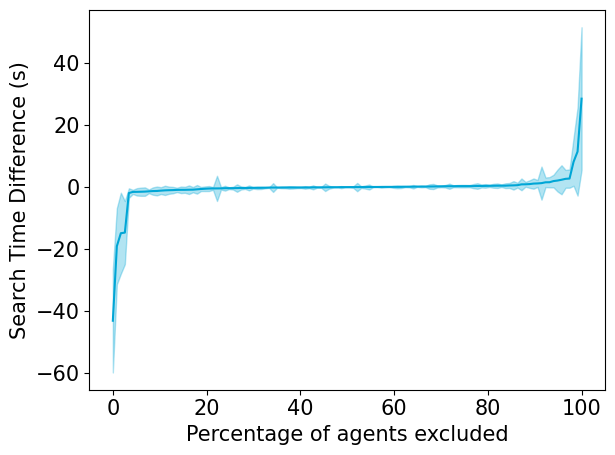

In [16]:
df = pd.concat(dfs, axis=0, keys=list(range(len(dfs))))
df["repeat"] = pd.to_numeric(df["repeat"])
df["Search Time"] = pd.to_numeric(df["Search Time"])

def str_to_set(item: str):
    return set(item[1:-1].split(", "))

df["trains excluded"] = df["trains excluded"].apply(str_to_set)
differences = (
    df.groupby("repeat")
    [["Search Time", "trains excluded"]].diff()
)
differences["trains excluded"] = differences["trains excluded"].apply(lambda x: int(x.pop()[9:-1]) if isinstance(x, set) and len(x) > 0 else np.nan)
differences = (differences.groupby("trains excluded")
               .agg({"Search Time":["mean", "std"]})
               .set_axis(["mean", "std"], axis=1)
               .sort_values("mean")
               .reset_index())
diff_plot = differences[["mean", "std"]]
diff_plot.index = diff_plot.index / diff_plot.index.max() * 100
plt.rcParams.update({'font.size': 15})
ax = diff_plot["mean"].plot(color="#00A6D6")
ax.fill_between(diff_plot.index, diff_plot["mean"] - diff_plot["std"] / 2, diff_plot["mean"] + diff_plot["std"] / 2, color="#00A6D6", alpha=0.3)
plt.ylabel("Search Time Difference (s)")
plt.xlabel("Percentage of agents excluded")
plt.tight_layout()
plt.savefig(save_path.parent / "differences.png")

df2 = differences.set_index("trains excluded").join(agent_df)[["mean", "origin", "destination", "startTimeHuman", "endTimeHuman", "trainNumber", "trainUnitTypes"]]
df2.loc[df2["mean"].abs() > 3]

,mean,std
0,41.3887,2.309496
1,41.7677,2.092212
2,41.5552,2.208344
3,40.0733,2.282388
4,44.7377,15.297693
...,...,...
114,1.0707,0.390464
115,1.0499,0.394348
116,1.0400,0.387101
117,0.8656,0.294597


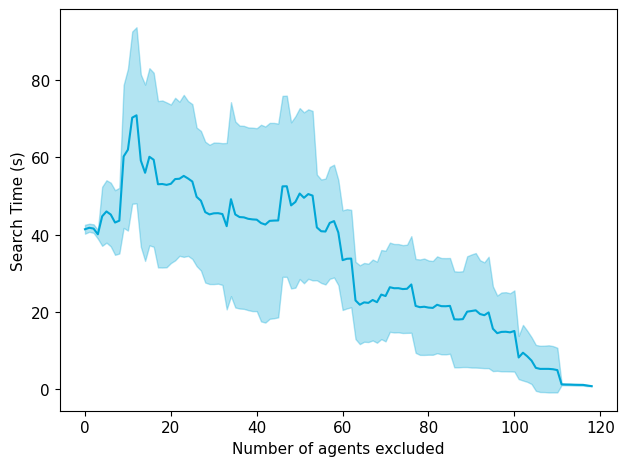

In [27]:
df["Number of agents excluded"] = df["trains excluded"].apply(len)

time_mean_std = (
    df.groupby(["Number of agents excluded"]).agg({"Search Time":["mean", "std"]})
    .set_axis(["mean", "std"], axis=1)
    .reset_index()
    [["mean", "std"]]
)
plt.rcParams.update({'font.size': 11})
fig, ax = plt.subplots()

ax = time_mean_std["mean"].plot(ax=ax, color="#00A6D6", legend=False)
ax.fill_between(time_mean_std.index, time_mean_std["mean"] - time_mean_std["std"] / 2, time_mean_std["mean"] + time_mean_std["std"] / 2, color="#00A6D6", alpha=0.3)
# time_df.loc[time_df["Search Time"] > -1]["Search Time"].plot()
plt.ylabel("Search Time (s)")
plt.xlabel("Number of agents excluded")
plt.tight_layout()
plt.savefig(str(save_path.parent / "agents_excluded.png"))
time_mean_std

Average path length  Total paths  nodes generated  nodes decreased  \
  label                                                                       
0 0                    21.75            4              617               87   
  1                    21.75            4              628               87   
  2                    21.75            4              620               87   
  3                    21.75            4              620               87   
  4                    21.75            4              612               87   
...                      ...          ...              ...              ...   
9 115                  30.00            2               50                0   
  116                  30.00            2               50                0   
  117                  30.00            2               50                0   
  118                  30.00            2               50                0   
  119                  30.00            2               50                0   

         nodes expanded  expected_arrival  repeat  \
  label                                             
0 0                 360            3060.0       0   
  1                 371            3060.0       0   
  2                 371            3060.0       0   
  3                 371            3060.0       0   
  4                 370            3060.0       0   
...                 ...               ...     ...   
9 115                29            3060.0       9   
  116                29            3060.0       9   
  117                29            3060.0       9   
  118                29            3060.0       9   
  119                29            3060.0       9   

                                           trains excluded color  offset  \
  label                                                                    
0 0                                         {np.int64(26)}   Red       0   
  1                           {np.int64(58), np.int64(26)}   Red       0   
  2             {np.int64(91), np.int64(58), np.int64(26)}   Red       0   
  3      {np.int64(91), np.int64(58), np.int64(26), np....   Red       0   
  4      {np.int64(47), np.int64(91), np.int64(5), np.i...   Red       0   
...                                                    ...   ...     ...   
9 115    {np.int64(106), np.int64(40), np.int64(78), np...   Red       0   
  116    {np.int64(106), np.int64(40), np.int64(78), np...   Red       0   
  117    {np.int64(106), np.int64(40), np.int64(78), np...   Red       0   
  118    {np.int64(106), np.int64(40), np.int64(78), np...   Red       0   
  119    {np.int64(106), np.int64(40), np.int64(78), np...   Red       0   

         Search Time  Normalized Search Time  Setup Time  Recompute Time  \
  label                                                                    
0 0           41.035                10.25875         NaN             NaN   
  1           41.677                10.41925         NaN             NaN   
  2           39.359                 9.83975         NaN             NaN   
  3           39.191                 9.79775         NaN             NaN   
  4           38.884                 9.72100         NaN             NaN   
...              ...                     ...         ...             ...   
9 115          0.706                 0.35300   67.093534      341.315675   
  116          0.703                 0.35150   67.093534      341.287884   
  117          0.705                 0.35250   67.093534      341.264493   
  118          0.704                 0.35200   67.093534      341.268549   
  119          0.706                 0.35300   67.093534      341.256378   

         Number of agents excluded  
  label                             
0 0                              1  
  1                              2  
  2                              3  
  3                              4  
  4                              5  
...                            ...  
9 115            

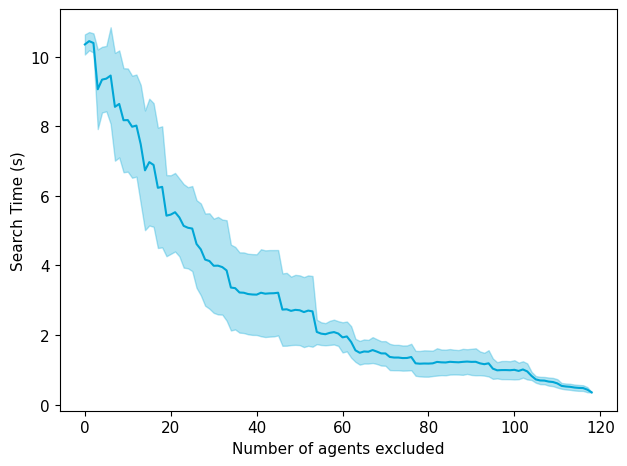

In [28]:
df["Number of agents excluded"] = df["trains excluded"].apply(len)

time_mean_std = (
    df.groupby(["Number of agents excluded"]).agg({"Normalized Search Time":["mean", "std"]})
    .set_axis(["mean", "std"], axis=1)
    .reset_index()
    [["mean", "std"]]
)
plt.rcParams.update({'font.size': 11})
fig, ax = plt.subplots()

ax = time_mean_std["mean"].plot(ax=ax, color="#00A6D6", legend=False)
ax.fill_between(time_mean_std.index, time_mean_std["mean"] - time_mean_std["std"] / 2, time_mean_std["mean"] + time_mean_std["std"] / 2, color="#00A6D6", alpha=0.3)
# time_df.loc[time_df["Search Time"] > -1]["Search Time"].plot()
plt.ylabel("Search Time (s)")
plt.xlabel("Number of agents excluded")
plt.tight_layout()
plt.savefig(str(save_path.parent / "agents_excluded_normalized.png"))
df

C:\Users\erick\Documents\uni\Thesis\delay-replannning\.venv\lib\site-packages\pandas\core\indexes\base.py:952: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*new_inputs, **kwargs)


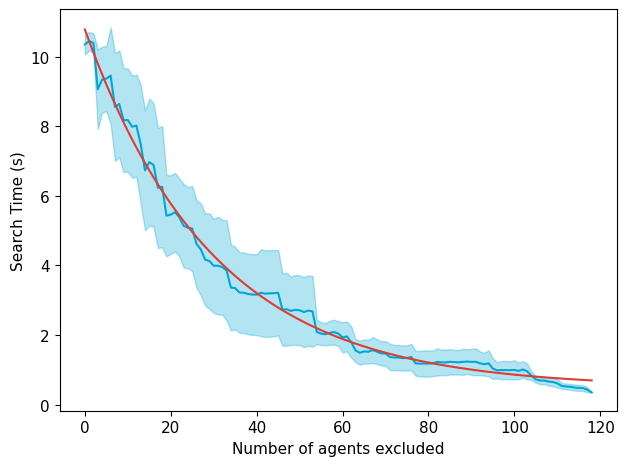

In [29]:
from scipy.optimize import curve_fit

plt.rcParams.update({'font.size': 11})
fig, ax = plt.subplots()

x = time_mean_std.index
y = time_mean_std["mean"]
std = time_mean_std["std"]

def func(x, a, b, c):
    return a * np.exp(-b * x) + c

popt, pcov = curve_fit(func, x, y)

ax = y.plot(ax=ax, color="#00A6D6", legend=False)
ax.fill_between(x, y - std / 2, y + std / 2, color="#00A6D6", alpha=0.3)
_ = ax.plot(x,  func(x, *popt), '-', color="#E03C31")
# time_df.loc[time_df["Search Time"] > -1]["Search Time"].plot()
plt.ylabel("Search Time (s)")
plt.xlabel("Number of agents excluded")
plt.tight_layout()
plt.savefig(str(save_path.parent / "agents_excluded_normalized_fitted.png"))